In [72]:
import os
import random
import time
import json
import warnings 
warnings.filterwarnings('ignore')

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import cv2

import numpy as np
import pandas as pd

# 전처리를 위한 라이브러리
from pycocotools.coco import COCO
import torchvision
import torchvision.transforms as transforms

import albumentations as A
from albumentations.pytorch import ToTensorV2

# 시각화를 위한 라이브러리
import matplotlib.pyplot as plt

plt.rcParams['axes.grid'] = False
batch_size=16

In [84]:
class CustomDataset(Dataset):
    '''
      data_dir: data가 존재하는 폴더 경로
      transforms: data transform (resize, crop, Totensor, etc,,,)
    '''

    def __init__(self, annotation, data_dir, transforms=None):
        super().__init__()
        self.data_dir = data_dir
        # coco annotation 불러오기 (coco API)
        self.coco = COCO(annotation)
        self.predictions = {
            "images": self.coco.dataset["images"].copy(),
            "categories": self.coco.dataset["categories"].copy(),
            "annotations": None
        }
        self.transforms = transforms

    def __getitem__(self, index: int):
        
        image_id = self.coco.getImgIds(imgIds=index)

        image_info = self.coco.loadImgs(image_id)[0]
        
        image = cv2.imread(os.path.join(self.data_dir, image_info['file_name']))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#         image /= 255.0

        ann_ids = self.coco.getAnnIds(imgIds=image_info['id'])
        anns = self.coco.loadAnns(ann_ids)

        boxes = np.array([x['bbox'] for x in anns])

        # boxex (x_min, y_min, x_max, y_max)
        boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
        boxes[:, 3] = boxes[:, 1] + boxes[:, 3]
        
        labels = np.array([x['category_id'] for x in anns])
        labels = torch.as_tensor(labels, dtype=torch.int64)
        
        areas = np.array([x['area'] for x in anns])
        areas = torch.as_tensor(areas, dtype=torch.float32)
                                
        is_crowds = np.array([x['iscrowd'] for x in anns])
        is_crowds = torch.as_tensor(is_crowds, dtype=torch.int64)
                                
        segmentation = np.array([x['segmentation'] for x in anns], dtype=object)

        target = {'boxes': boxes, 'labels': labels, 'image_id': torch.tensor([index]), 'area': areas,
                  'iscrowd': is_crowds}

        # transform
        if self.transforms:
            sample = {
                'image': image,
                'bboxes': target['boxes'],
                'labels': labels
            }
            sample = self.transforms(**sample)
            image = sample['image']
            target['boxes'] = torch.tensor(sample['bboxes'], dtype=torch.float32)
        
        # yolo model format
        # result = []
        # labels_out = torch.zeros((len(labels), 6))
        # for i in range(len(labels)):
        #     result.append(
        #         [labels[i], target['boxes'][i][0], target['boxes'][i][1], target['boxes'][i][2], target['boxes'][i][3]]
        #     )
        # result = np.array(result)

        # if len(labels):
        #     labels_out[:, 1:] = torch.from_numpy(result)

        return image, target, image_id
    
    def __len__(self) -> int:
        return len(self.coco.getImgIds())

In [143]:
def collate_fn(batch):
    return tuple(zip(*batch))

def get_train_transform():
    return A.Compose([
        A.Resize(512, 512),
        A.Flip(p=0.5),
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})


def get_valid_transform():
    return A.Compose([
#         A.Resize(512, 512),
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

In [144]:
import matplotlib.patches as patches
annotation = '/opt/ml/input/data/train.json'
data_dir = '/opt/ml/input/data'
train_dataset = CustomDataset(annotation, data_dir, get_train_transform())
# train_dataset = CustomDataset(annotation, data_dir)

train_data_loader = DataLoader(
    train_dataset,
    batch_size=32,
    shuffle=False,
    num_workers=4,
    collate_fn=collate_fn)

loading annotations into memory...
Done (t=3.70s)
creating index...
index created!


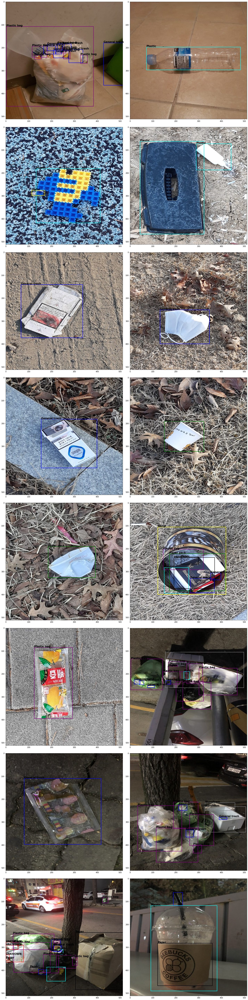

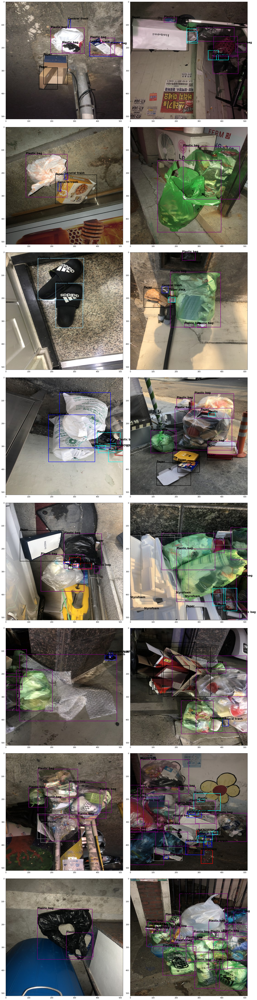

In [145]:
color = ['red', 'blue', 'black', 'green', 'yellow', 'orange', 'cyan', 'gray', 'purple', 'tomato', 'skyblue']
classes = ["UNKNOWN", "General trash", "Paper", "Paper pack", "Metal", "Glass",
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]

for idx, (imgs, target, image_id) in enumerate(train_data_loader):
    fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(20, 80))
    plt.tight_layout()
    for i in range(batch_size):
        label = target[i]['labels']
        x = target[i]['boxes'][:, 0]
        y = target[i]['boxes'][:, 1]
        w = target[i]['boxes'][:, 2]
        h = target[i]['boxes'][:, 3]
        j = i // 2
        l = i % 2
        axes[j,l].imshow(imgs[i].permute([1,2,0]))
        for k in range(len(x)):
            axes[j,l].add_patch(
             patches.Rectangle(
                (x[k], y[k]),
                w[k]-x[k],
                h[k]-y[k],
                edgecolor = color[label[k]],
                facecolor = 'red',
                fill=False,
                linewidth=2
             ))
            axes[j,l].text(x[k], y[k], classes[label[k]], fontsize=15, color='black', weight='bold')
    plt.show()
    if idx == 1:
        break
